<a href="https://colab.research.google.com/github/ryu-1113/ML-interpretation/blob/patch1.1/mushroom.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# SHAP Enviroment
```



In [1]:
pip install SHAP

In [2]:
import shap

Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)


# Import dataset

In [3]:
!pip install kaggle


In [4]:
import json
token = {"username":"ruiyuwang1113","key":"359b680e4fe8fd93b79bb78e313714b8"}
with open('/content/kaggle.json', 'w') as file:
  json.dump(token, file)

In [5]:
!mkdir -p ~/.kaggle

In [6]:
!cp /content/kaggle.json ~/.kaggle/

In [7]:
!chmod 600 ~/.kaggle/kaggle.json

In [8]:
!kaggle config set -n path -v /content

- path is now set to: /content


In [9]:
!kaggle datasets download -d uciml/mushroom-classification

mushroom-classification.zip: Skipping, found more recently modified local copy (use --force to force download)


In [10]:
!unzip -n '../content/datasets/uciml/mushroom-classification/mushroom-classification.zip' -d '../content/datasets/uciml/mushroom-classification'

Archive:  ../content/datasets/uciml/mushroom-classification/mushroom-classification.zip


In [11]:
import pandas as pd
import numpy as np

In [12]:
data = pd.read_csv('../content/datasets/uciml/mushroom-classification/mushrooms.csv')
data.shape


(8124, 23)

In [13]:
data.head()


,class,cap-shape,cap-surface,cap-color,bruises,odor,gill-attachment,gill-spacing,gill-size,gill-color,...,stalk-surface-below-ring,stalk-color-above-ring,stalk-color-below-ring,veil-type,veil-color,ring-number,ring-type,spore-print-color,population,habitat
0,p,x,s,n,t,p,f,c,n,k,...,s,w,w,p,w,o,p,k,s,u
1,e,x,s,y,t,a,f,c,b,k,...,s,w,w,p,w,o,p,n,n,g
2,e,b,s,w,t,l,f,c,b,n,...,s,w,w,p,w,o,p,n,n,m
3,p,x,y,w,t,p,f,c,n,n,...,s,w,w,p,w,o,p,k,s,u
4,e,x,s,g,f,n,f,w,b,k,...,s,w,w,p,w,o,e,n,a,g


In [14]:
data.columns

Index(['class', 'cap-shape', 'cap-surface', 'cap-color', 'bruises', 'odor',
       'gill-attachment', 'gill-spacing', 'gill-size', 'gill-color',
       'stalk-shape', 'stalk-root', 'stalk-surface-above-ring',
       'stalk-surface-below-ring', 'stalk-color-above-ring',
       'stalk-color-below-ring', 'veil-type', 'veil-color', 'ring-number',
       'ring-type', 'spore-print-color', 'population', 'habitat'],
      dtype='object')

In [15]:
data.isnull().sum()

class                       0
cap-shape                   0
cap-surface                 0
cap-color                   0
bruises                     0
odor                        0
gill-attachment             0
gill-spacing                0
gill-size                   0
gill-color                  0
stalk-shape                 0
stalk-root                  0
stalk-surface-above-ring    0
stalk-surface-below-ring    0
stalk-color-above-ring      0
stalk-color-below-ring      0
veil-type                   0
veil-color                  0
ring-number                 0
ring-type                   0
spore-print-color           0
population                  0
habitat                     0
dtype: int64

In [16]:
data["class"].value_counts()

e    4208
p    3916
Name: class, dtype: int64

In [17]:
from sklearn.preprocessing import LabelEncoder
labelencoder=LabelEncoder()
for col in data.columns:
    data[col] = labelencoder.fit_transform(data[col])

data.head()

,class,cap-shape,cap-surface,cap-color,bruises,odor,gill-attachment,gill-spacing,gill-size,gill-color,...,stalk-surface-below-ring,stalk-color-above-ring,stalk-color-below-ring,veil-type,veil-color,ring-number,ring-type,spore-print-color,population,habitat
0,1,5,2,4,1,6,1,0,1,4,...,2,7,7,0,2,1,4,2,3,5
1,0,5,2,9,1,0,1,0,0,4,...,2,7,7,0,2,1,4,3,2,1
2,0,0,2,8,1,3,1,0,0,5,...,2,7,7,0,2,1,4,3,2,3
3,1,5,3,8,1,6,1,0,1,5,...,2,7,7,0,2,1,4,2,3,5
4,0,5,2,3,0,5,1,1,0,4,...,2,7,7,0,2,1,0,3,0,1


In [18]:
data['stalk-color-above-ring'].value_counts()

7    4464
6    1872
3     576
4     448
0     432
5     192
2      96
1      36
8       8
Name: stalk-color-above-ring, dtype: int64

In [19]:
print(data.groupby('class').size())

class
0    4208
1    3916
dtype: int64


In [20]:
X = data.iloc[:,1:23]  # all rows, all the features and no labels
y = data.iloc[:, 0]  # all rows, label only
X_display = data.iloc[:,1:23]
X.head()
y.head()

0    1
1    0
2    0
3    1
4    0
Name: class, dtype: int64

In [21]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.2,random_state=42)

# DecisionTree Classifier





In [22]:
from sklearn.experimental import enable_halving_search_cv
from sklearn.model_selection import HalvingGridSearchCV, KFold

In [54]:
from sklearn.tree import DecisionTreeClassifier

param_grid_DT_0 = {
    'max_depth': [ 5, 10,15 ,20],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

model_DT_0 = DecisionTreeClassifier()
K_fold =  KFold(n_splits=10, shuffle=True, random_state=42)


In [55]:

halving_search_DT_0 = HalvingGridSearchCV(model_DT_0, param_grid_DT_0, scoring='f1', n_jobs=-1, verbose=2, return_train_score=True, cv = K_fold)


halving_search_DT_0.fit(X, y)


n_iterations: 4
n_required_iterations: 4
n_possible_iterations: 4
min_resources_: 300
max_resources_: 8124
aggressive_elimination: False
factor: 3
----------
iter: 0
n_candidates: 36
n_resources: 300
Fitting 10 folds for each of 36 candidates, totalling 360 fits
----------
iter: 1
n_candidates: 12
n_resources: 900
Fitting 10 folds for each of 12 candidates, totalling 120 fits
----------
iter: 2
n_candidates: 4
n_resources: 2700
Fitting 10 folds for each of 4 candidates, totalling 40 fits
----------
iter: 3
n_candidates: 2
n_resources: 8100
Fitting 10 folds for each of 2 candidates, totalling 20 fits


HalvingGridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=True),
                    estimator=DecisionTreeClassifier(), n_jobs=-1,
                    param_grid={'max_depth': [5, 10, 15, 20],
                                'min_samples_leaf': [1, 2, 4],
                                'min_samples_split': [2, 5, 10]},
                    scoring='f1', verbose=2)

In [56]:
cv_results = halving_search_DT_0.cv_results_
print("Mean test f1-score:", cv_results['mean_test_score'])
print("Mean train f1-score:", cv_results['mean_train_score'])

Mean test f1-score: [0.97451988 0.96929011 0.96463532 0.94807659 0.94398302 0.94398302
 0.94418464 0.94740433 0.94740433 0.96402653 0.96495681 0.97198852
 0.94699378 0.94699378 0.94398302 0.94418464 0.94740433 0.94740433
 0.97321507 0.9718255  0.96463532 0.94807659 0.94398302 0.94398302
 0.94418464 0.94740433 0.94740433 0.97321507 0.96880131 0.97198852
 0.94525401 0.94398302 0.94699378 0.94418464 0.94418464 0.94740433
 0.99508122 0.9915585  0.98215708 0.99501026 0.99395763 0.97945438
 0.99634314 0.9915585  0.99258921 0.9938167  0.9927148  0.98215708
 1.         1.         1.         1.         1.         1.        ]
Mean train f1-score: [0.99644384 0.996088   0.99227588 0.99025108 0.99026167 0.98588282
 0.97942252 0.97942252 0.97879853 1.         0.99888425 0.9939172
 0.9918564  0.99026167 0.98588282 0.97942252 0.97942252 0.97879853
 1.         0.99888425 0.9939172  0.9918564  0.99026167 0.98588282
 0.97942252 0.97942252 0.97879853 1.         0.99888425 0.9939172
 0.9918564  0.99026167

In [57]:
# gain the best hyperparameters
best_params_DT_0 = halving_search_DT_0.best_params_

# gain the best model
best_model_DT_0 = halving_search_DT_0.best_estimator_
best_params_DT_0

{'max_depth': 10, 'min_samples_leaf': 1, 'min_samples_split': 2}

In [58]:
shap.initjs()
explainer_DT_0 = shap.TreeExplainer(best_model_DT_0)

shap_values_DT_0 = explainer_DT_0.shap_values(X_test)
shap_values2_DT_0 = explainer_DT_0(X_test)
shap.force_plot(explainer_DT_0.expected_value[0], shap_values_DT_0[0], X_test)

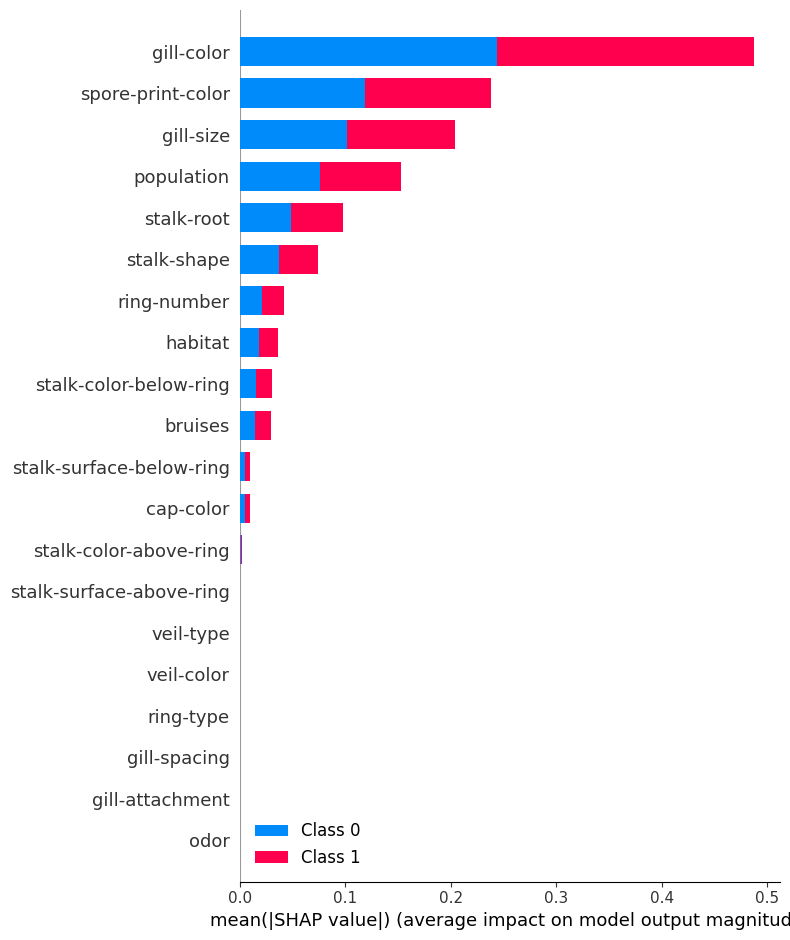

In [59]:
shap.initjs()
shap.summary_plot(shap_values_DT_0, X_test, plot_type="bar")



In [60]:
shap_values_DT_0

[array([[ 0.00000000e+00,  0.00000000e+00,  1.63923742e-03, ...,
          5.80410517e-02,  2.00676538e-01, -1.98055001e-02],
        [ 0.00000000e+00,  0.00000000e+00,  5.01067230e-04, ...,
          2.35428593e-02, -4.78144252e-02,  1.80558337e-02],
        [ 0.00000000e+00,  0.00000000e+00,  5.01067230e-04, ...,
          2.35428593e-02, -4.78144252e-02,  1.80558337e-02],
        ...,
        [ 0.00000000e+00,  0.00000000e+00,  5.01067230e-04, ...,
          2.35428593e-02, -4.78144252e-02,  1.80558337e-02],
        [ 0.00000000e+00,  0.00000000e+00,  5.01067230e-04, ...,
          2.35428593e-02, -4.78144252e-02,  1.80558337e-02],
        [ 0.00000000e+00,  0.00000000e+00,  2.01366769e-03, ...,
         -6.31126749e-01, -2.09634696e-02,  8.67302259e-03]]),
 array([[ 0.00000000e+00,  0.00000000e+00, -1.63923742e-03, ...,
         -5.80410517e-02, -2.00676538e-01,  1.98055001e-02],
        [ 0.00000000e+00,  0.00000000e+00, -5.01067230e-04, ...,
         -2.35428593e-02,  4.78144252e

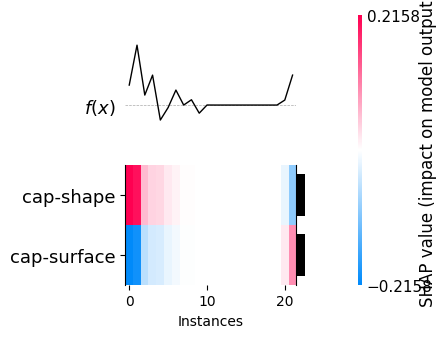

In [65]:
shap.initjs()
shap.plots.heatmap(shap_values2_DT_0[0])

# GradientBoosting Classifier

In [31]:
from sklearn.ensemble import GradientBoostingClassifier


In [40]:
GBDT_0 = GradientBoostingClassifier()
param_grid_GBDT_0 = {
    'n_estimators': [10,20,30,40,50],     # no of trees
    'learning_rate': [0.01, 0.1, 0.2],       # learning rate
    'max_depth': [3, 5, 7, 10],              # max depth of trees
    'subsample': [0.8, 1.0],                 # fraction of instances
    'max_features': ['auto', 'sqrt', 0.5],   # fraction of features
}



In [41]:

halving_search_GBDT_0 = HalvingGridSearchCV(GBDT_0, param_grid_GBDT_0, scoring='f1', n_jobs=-1, verbose=2, return_train_score=True, cv = K_fold)


halving_search_GBDT_0.fit(X, y)


n_iterations: 5
n_required_iterations: 6
n_possible_iterations: 5
min_resources_: 40
max_resources_: 8124
aggressive_elimination: False
factor: 3
----------
iter: 0
n_candidates: 360
n_resources: 40
Fitting 10 folds for each of 360 candidates, totalling 3600 fits
----------
iter: 1
n_candidates: 120
n_resources: 120
Fitting 10 folds for each of 120 candidates, totalling 1200 fits
----------
iter: 2
n_candidates: 40
n_resources: 360
Fitting 10 folds for each of 40 candidates, totalling 400 fits
----------
iter: 3
n_candidates: 14
n_resources: 1080
Fitting 10 folds for each of 14 candidates, totalling 140 fits
----------
iter: 4
n_candidates: 5
n_resources: 3240
Fitting 10 folds for each of 5 candidates, totalling 50 fits


HalvingGridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=True),
                    estimator=GradientBoostingClassifier(), n_jobs=-1,
                    param_grid={'learning_rate': [0.01, 0.1, 0.2],
                                'max_depth': [3, 5, 7, 10],
                                'max_features': ['auto', 'sqrt', 0.5],
                                'n_estimators': [10, 20, 30, 40, 50],
                                'subsample': [0.8, 1.0]},
                    scoring='f1', verbose=2)

In [42]:
cv_results_GBDT_0 = halving_search_GBDT_0.cv_results_
print("Mean test f1-score:", cv_results_GBDT_0['mean_test_score'])
print("Mean train f1-score:", cv_results_GBDT_0['mean_train_score'])

Mean test f1-score: [0.44666667 0.48       0.53333333 0.76666667 0.8        0.96666667
 0.83333333 0.96666667 0.83333333 0.96666667 0.34666667 0.34666667
 0.33333333 0.36666667 0.66666667 0.8        0.7        0.8
 0.8        0.8        0.34666667 0.34666667 0.33333333 0.43333333
 0.8        0.8        0.83333333 0.83333333 0.83333333 0.83333333
 0.34666667 0.48       0.63333333 0.76666667 0.8        0.96666667
 0.86666667 0.94666667 0.83333333 0.96666667 0.31333333 0.34666667
 0.33333333 0.33333333 0.8        0.83333333 0.8        0.83333333
 0.83333333 0.83333333 0.34666667 0.34666667 0.53333333 0.53333333
 0.8        0.83333333 0.83333333 0.83333333 0.83333333 0.83333333
 0.44666667 0.48       0.53333333 0.76666667 0.8        0.96666667
 0.83333333 0.96666667 0.86666667 0.96666667 0.31333333 0.34666667
 0.43333333 0.43333333 0.8        0.73333333 0.8        0.83333333
 0.83333333 0.83333333 0.34666667 0.34666667 0.33333333 0.53333333
 0.8        0.83333333 0.83333333 0.83333333 0.83

In [43]:
# gain the best hyperparameters
best_params_GBDT_0 = halving_search_GBDT_0.best_params_

# gain the best model
best_model_GBDT_0 = halving_search_GBDT_0.best_estimator_
best_params_GBDT_0

{'learning_rate': 0.1,
 'max_depth': 5,
 'max_features': 'sqrt',
 'n_estimators': 50,
 'subsample': 1.0}

In [44]:
shap.initjs()
explainer_GBDT_0 = shap.Explainer(best_model_GBDT_0)
shap_values_GBDT_0 = explainer_GBDT_0.shap_values(X_test)

shap_values2_GBDT_0 = explainer_GBDT_0(X_test)
shap.force_plot(explainer_GBDT_0.expected_value, shap_values_GBDT_0, X_test)



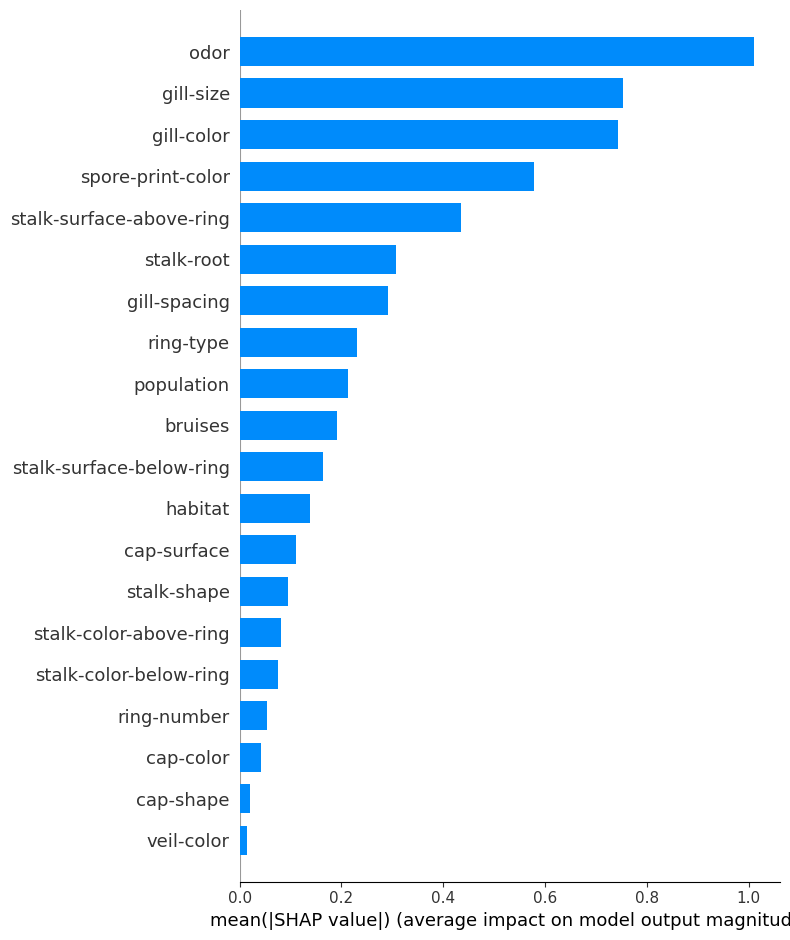

In [45]:
shap.initjs()
shap.summary_plot(shap_values_GBDT_0, X, plot_type="bar")

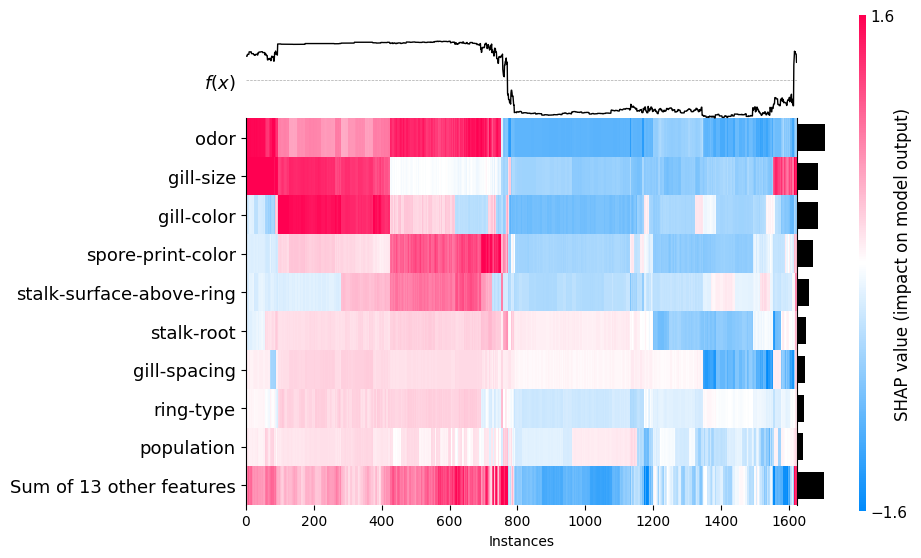

In [46]:
shap.initjs()
shap.plots.heatmap(shap_values2_GBDT_0)

# Noise Addition

In [68]:
from sklearn.utils import shuffle
def noise_addition(f,str):
  noise_ratio = f
  total_samples = len(data)
  noise_samples = int(total_samples * noise_ratio)
  mushroom_data = data.copy()
  attribute_labels = mushroom_data[str].unique()
  global_distribution = mushroom_data[str].value_counts(normalize=True)
  # 计算每个类别需要添加的噪声样本数量，保持全局分布
  noise_counts = (global_distribution * len(mushroom_data) * noise_ratio).astype(int)

  # 为每个类别生成随机噪声数据并进行替换
  for label, count in noise_counts.items():
      # 获取该类别的索引
      indices = mushroom_data.index[mushroom_data[str] == label].tolist()
    # 从索引中随机选择需要替换的样本
      replace_indices = np.random.choice(indices, count, replace=False)

    # 获取该类别需要替换为的其他类别
      other_labels = global_distribution.index[global_distribution.index != label]
      replace_label = np.random.choice(other_labels)

    # 将该类别的样本替换为其他随机类别
      mushroom_data.loc[replace_indices, str] = replace_label





  return mushroom_data












In [69]:
print(data.groupby('odor').size())

odor
0     400
1     192
2    2160
3     400
4      36
5    3528
6     256
7     576
8     576
dtype: int64


# noise level 5% odor

In [72]:
data_5 = noise_addition(0.05,'odor')
print(data_5.groupby('odor').size())

odor
0     380
1     183
2    2064
3     390
4     231
5    3536
6     244
7     548
8     548
dtype: int64


In [74]:
X_5 = data_5.iloc[:,1:23]  # all rows, all the features and no labels
y_5 = data_5.iloc[:, 0]  # all rows, label only
X_5.head()
y_5.head()

0    1
1    0
2    0
3    1
4    0
Name: class, dtype: int64

In [75]:
X5_train, X5_test, y5_train, y5_test = train_test_split(X_5,y_5,test_size=0.2,random_state=42)

In [78]:
# model
model_DT_5 = DecisionTreeClassifier()
param_grid_DT_5 = {
    'max_depth': [ 5, 10,15 ,20],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}





In [91]:

halving_search_DT_5 = HalvingGridSearchCV(model_DT_5, param_grid_DT_5, scoring='f1', n_jobs=-1, verbose=2, return_train_score=True, cv = K_fold)


halving_search_DT_5.fit(X_5, y_5)


n_iterations: 4
n_required_iterations: 4
n_possible_iterations: 4
min_resources_: 300
max_resources_: 8124
aggressive_elimination: False
factor: 3
----------
iter: 0
n_candidates: 36
n_resources: 300
Fitting 10 folds for each of 36 candidates, totalling 360 fits
----------
iter: 1
n_candidates: 12
n_resources: 900
Fitting 10 folds for each of 12 candidates, totalling 120 fits
----------
iter: 2
n_candidates: 4
n_resources: 2700
Fitting 10 folds for each of 4 candidates, totalling 40 fits
----------
iter: 3
n_candidates: 2
n_resources: 8100
Fitting 10 folds for each of 2 candidates, totalling 20 fits


HalvingGridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=True),
                    estimator=DecisionTreeClassifier(), n_jobs=-1,
                    param_grid={'max_depth': [5, 10, 15, 20],
                                'min_samples_leaf': [1, 2, 4],
                                'min_samples_split': [2, 5, 10]},
                    scoring='f1', verbose=2)

In [92]:
cv_results_DT_5 = halving_search_DT_5.cv_results_
print("Mean test f1-score:", cv_results_DT_5['mean_test_score'])
print("Mean train f1-score:", cv_results_DT_5['mean_train_score'])

Mean test f1-score: [0.95048666 0.94156367 0.95048666 0.94373187 0.94770012 0.94837599
 0.94065194 0.94028513 0.94526023 0.9496152  0.94156367 0.9459115
 0.94770012 0.94373187 0.94837599 0.93951885 0.94382654 0.94095254
 0.93756367 0.94213883 0.93794324 0.94770012 0.95237848 0.94837599
 0.94382654 0.93951885 0.94526023 0.9459115  0.94984254 0.95048666
 0.94841023 0.95237848 0.94837599 0.93951885 0.93951885 0.94095254
 0.99038627 0.97011431 0.99038627 0.99038627 0.99156274 0.99156274
 0.99059204 0.97011431 0.99038627 0.97011431 0.99059204 0.99156274
 0.99770592 0.99810118 0.99849027 0.99771428 1.         1.        ]
Mean train f1-score: [0.99367671 0.99102164 0.98838001 0.98754854 0.98724809 0.98496176
 0.97368183 0.97325694 0.9711716  1.         0.99508037 0.98968996
 0.99044696 0.98936247 0.98584646 0.97410305 0.97452794 0.97074671
 1.         0.99507402 0.98929471 0.99044696 0.99015294 0.98584646
 0.97452794 0.97410305 0.9711716  1.         0.99507402 0.98968996
 0.99044693 0.9897577

In [93]:
# gain the best hyperparameters
best_params_DT_5 = halving_search_DT_5.best_params_

# gain the best model
best_model_DT_5 = halving_search_DT_5.best_estimator_
best_params_DT_5

{'max_depth': 20, 'min_samples_leaf': 2, 'min_samples_split': 2}

In [94]:
shap.initjs()
explainer_DT_5 = shap.TreeExplainer(best_model_DT_5)
shap_values_DT_5 = explainer_DT_5.shap_values(X5_test)
shap_values2_DT_5 = explainer_DT_5(X_5)

shap.force_plot(explainer_DT_5.expected_value[0], shap_values_DT_5[0], X5_test)


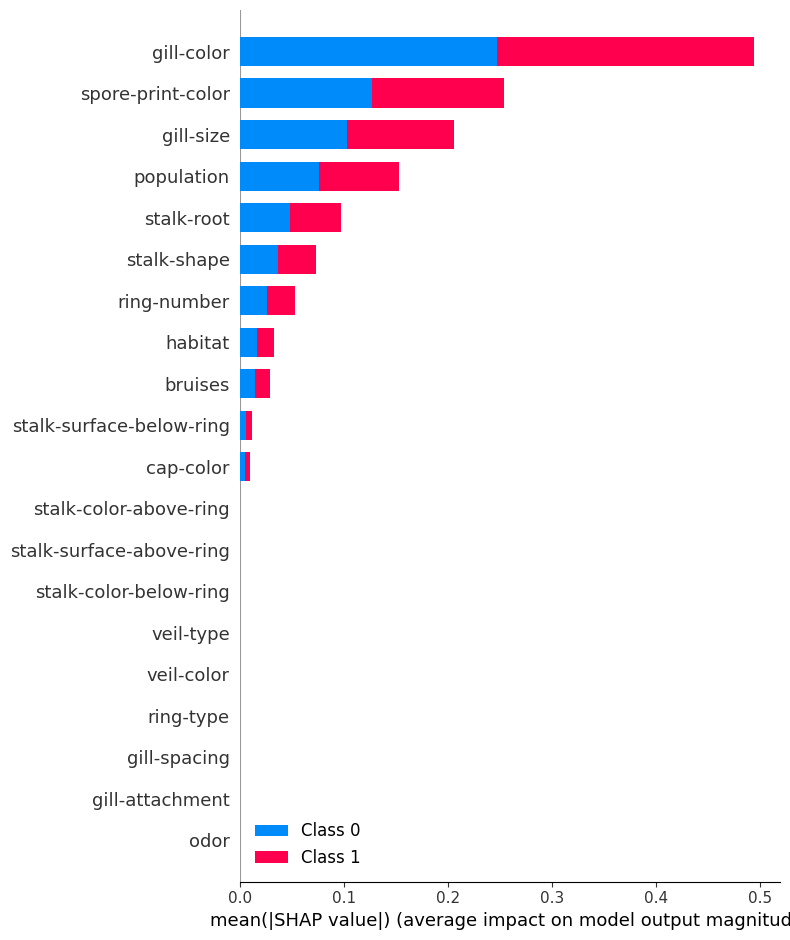

In [95]:
shap.initjs()
shap.summary_plot(shap_values_DT_5, X5_test, plot_type="bar")

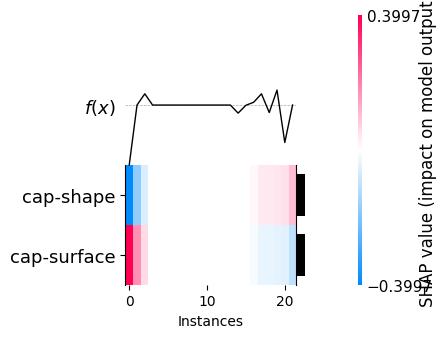

In [96]:
shap.initjs()
shap.plots.heatmap(shap_values2_DT_5[0])

In [97]:
GBDT_5 = GradientBoostingClassifier()
param_grid_GBDT_5 = {
    'n_estimators': [10,20,30,40,50],     # no of trees
    'learning_rate': [0.01, 0.1, 0.2],       # learning rate
    'max_depth': [3, 5, 7, 10],              # max depth of trees
    'subsample': [0.8, 1.0],                 # fraction of instances
    'max_features': ['auto', 'sqrt', 0.5],   # fraction of features
}



In [99]:

halving_search_GBDT_5 = HalvingGridSearchCV(GBDT_5, param_grid_GBDT_5, scoring='f1', n_jobs=-1, verbose=2, return_train_score=True, cv = K_fold)


halving_search_GBDT_5.fit(X_5, y_5)


n_iterations: 5
n_required_iterations: 6
n_possible_iterations: 5
min_resources_: 40
max_resources_: 8124
aggressive_elimination: False
factor: 3
----------
iter: 0
n_candidates: 360
n_resources: 40
Fitting 10 folds for each of 360 candidates, totalling 3600 fits
----------
iter: 1
n_candidates: 120
n_resources: 120
Fitting 10 folds for each of 120 candidates, totalling 1200 fits
----------
iter: 2
n_candidates: 40
n_resources: 360
Fitting 10 folds for each of 40 candidates, totalling 400 fits
----------
iter: 3
n_candidates: 14
n_resources: 1080
Fitting 10 folds for each of 14 candidates, totalling 140 fits
----------
iter: 4
n_candidates: 5
n_resources: 3240
Fitting 10 folds for each of 5 candidates, totalling 50 fits


`max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
`max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
`max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
`max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
`max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
`max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
`max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
`max_features

HalvingGridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=True),
                    estimator=GradientBoostingClassifier(), n_jobs=-1,
                    param_grid={'learning_rate': [0.01, 0.1, 0.2],
                                'max_depth': [3, 5, 7, 10],
                                'max_features': ['auto', 'sqrt', 0.5],
                                'n_estimators': [10, 20, 30, 40, 50],
                                'subsample': [0.8, 1.0]},
                    scoring='f1', verbose=2)

In [100]:
cv_results_GBDT_5 = halving_search_GBDT_5.cv_results_
print("Mean test f1-score:", cv_results_GBDT_5['mean_test_score'])
print("Mean train f1-score:", cv_results_GBDT_5['mean_train_score'])

Mean test f1-score: [0.35333333 0.38666667 0.83666667 0.83666667 0.91333333 0.91333333
 0.91333333 0.91333333 0.91333333 0.91333333 0.35333333 0.35333333
 0.56666667 0.61666667 0.86333333 0.86333333 0.89333333 0.88
 0.88       0.91333333 0.38666667 0.38666667 0.83666667 0.72
 0.91333333 0.91333333 0.91333333 0.91333333 0.91333333 0.91333333
 0.35333333 0.38666667 0.73666667 0.83666667 0.91333333 0.91333333
 0.91333333 0.91333333 0.94666667 0.91333333 0.28666667 0.35333333
 0.6        0.72       0.88       0.88       0.91333333 0.91333333
 0.94666667 0.91333333 0.35333333 0.38666667 0.73666667 0.73666667
 0.91333333 0.91333333 0.91333333 0.91333333 0.94666667 0.91333333
 0.38666667 0.38666667 0.83666667 0.83666667 0.91333333 0.91333333
 0.91333333 0.91333333 0.91333333 0.91333333 0.38666667 0.38666667
 0.48666667 0.6        0.91333333 0.81333333 0.91333333 0.88
 0.88       0.88       0.38666667 0.35333333 0.73666667 0.73666667
 0.81333333 0.91333333 0.91333333 0.91333333 0.91333333 0.91

In [109]:
# gain the best hyperparameters
best_params_GBDT_5 = halving_search_GBDT_5.best_params_

# gain the best model
best_model_GBDT_5 = halving_search_GBDT_5.best_estimator_
best_params_GBDT_5

{'learning_rate': 0.1,
 'max_depth': 10,
 'max_features': 'auto',
 'n_estimators': 20,
 'subsample': 0.8}

In [110]:
shap.initjs()
explainer_GBDT_5 = shap.TreeExplainer(best_model_GBDT_5)
shap_values_GBDT_5 = explainer_GBDT_5.shap_values(X5_test)
shap_values2_GBDT_5 = explainer_GBDT_5(X5_test)
shap.force_plot(explainer_GBDT_5.expected_value[0], shap_values_GBDT_5, X5_test)


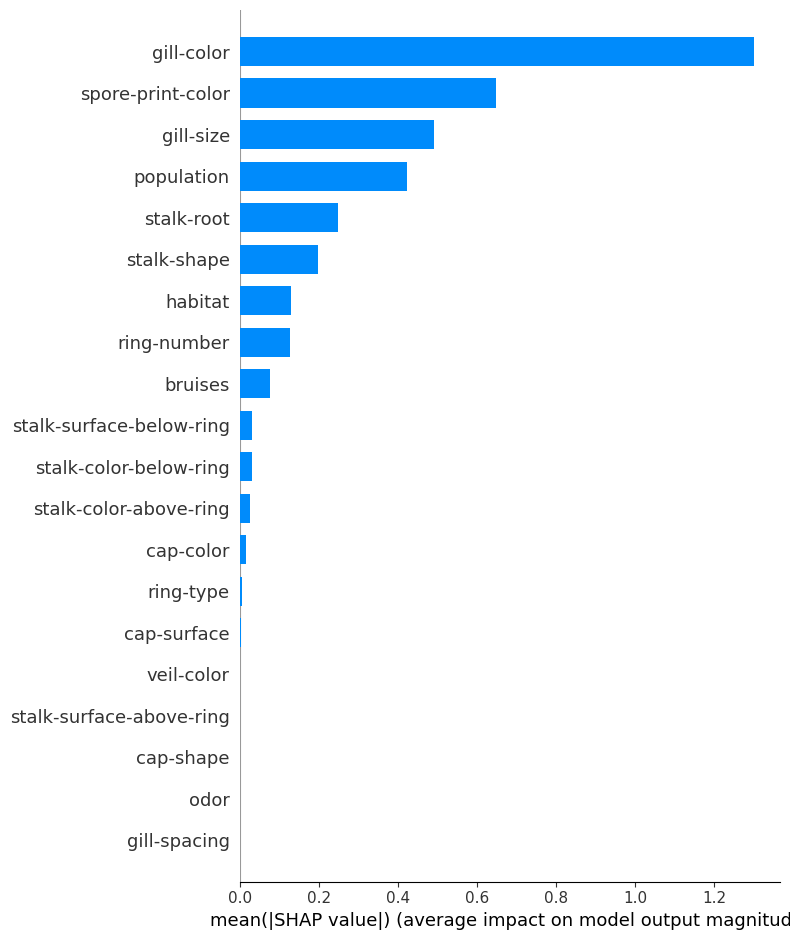

In [112]:
shap.initjs()
shap.summary_plot(shap_values_GBDT_5, X5_test, plot_type="bar")

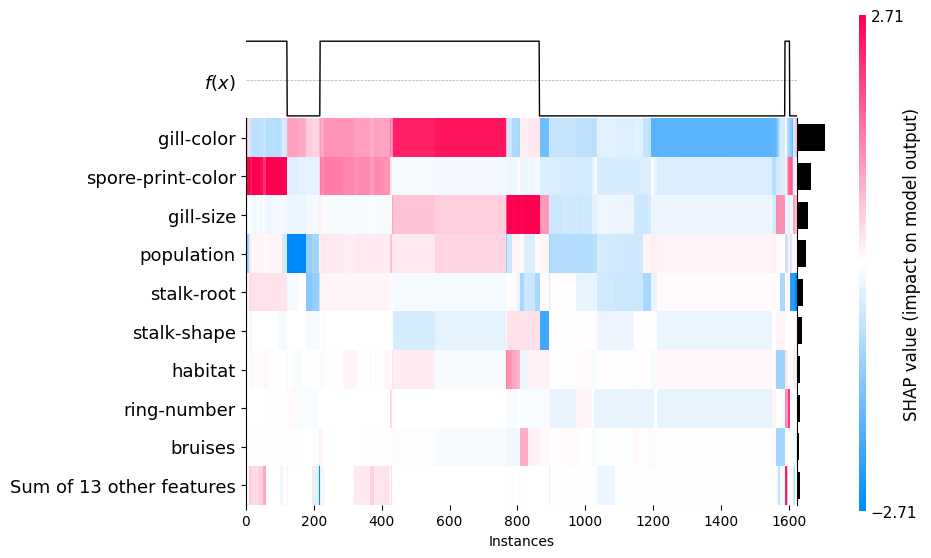

In [113]:
shap.initjs()
shap.plots.heatmap(shap_values2_GBDT_5)

# noise level 5 gill-color


In [116]:
data_5_gc = noise_addition(0.05,'gill-color')
print(data_5_gc.groupby('gill-color').size())
print(data.groupby('gill-color').size())

gill-color
0     1642
1      166
2      715
3      782
4      388
5     1000
6       85
7     1455
8       26
9      508
10    1194
11     163
dtype: int64
gill-color
0     1728
1       96
2      752
3      732
4      408
5     1048
6       64
7     1492
8       24
9      492
10    1202
11      86
dtype: int64


In [117]:
X_5_gc = data_5_gc.iloc[:,1:23]  # all rows, all the features and no labels
y_5_gc = data_5_gc.iloc[:, 0]  # all rows, label only
X_5_gc.head()
y_5_gc.head()

0    1
1    0
2    0
3    1
4    0
Name: class, dtype: int64

In [118]:
X5_gc_train, X5_gc_test, y5_gc_train, y5_gc_test = train_test_split(X_5_gc,y_5_gc,test_size=0.2,random_state=42)

In [119]:
# model
model_DT_5_gc = DecisionTreeClassifier()
param_grid_DT_5_gc = {
    'max_depth': [ 5, 10,15 ,20],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}





In [120]:

halving_search_DT_5_gc = HalvingGridSearchCV(model_DT_5_gc, param_grid_DT_5_gc, scoring='f1', n_jobs=-1, verbose=2, return_train_score=True, cv = K_fold)


halving_search_DT_5_gc.fit(X_5_gc, y_5_gc)


n_iterations: 4
n_required_iterations: 4
n_possible_iterations: 4
min_resources_: 300
max_resources_: 8124
aggressive_elimination: False
factor: 3
----------
iter: 0
n_candidates: 36
n_resources: 300
Fitting 10 folds for each of 36 candidates, totalling 360 fits
----------
iter: 1
n_candidates: 12
n_resources: 900
Fitting 10 folds for each of 12 candidates, totalling 120 fits
----------
iter: 2
n_candidates: 4
n_resources: 2700
Fitting 10 folds for each of 4 candidates, totalling 40 fits
----------
iter: 3
n_candidates: 2
n_resources: 8100
Fitting 10 folds for each of 2 candidates, totalling 20 fits


HalvingGridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=True),
                    estimator=DecisionTreeClassifier(), n_jobs=-1,
                    param_grid={'max_depth': [5, 10, 15, 20],
                                'min_samples_leaf': [1, 2, 4],
                                'min_samples_split': [2, 5, 10]},
                    scoring='f1', verbose=2)

In [121]:
cv_results_DT_5_gc = halving_search_DT_5_gc.cv_results_
print("Mean test f1-score:", cv_results_DT_5_gc['mean_test_score'])
print("Mean train f1-score:", cv_results_DT_5_gc['mean_train_score'])

Mean test f1-score: [0.97926599 0.97926599 0.97086772 0.97630172 0.97952142 0.97344458
 0.98046877 0.98046877 0.97192988 0.98564695 0.97926599 0.97318915
 0.97344458 0.97344458 0.97344458 0.98046877 0.97744458 0.98066428
 0.99153439 0.9822963  0.97086772 0.97952142 0.97952142 0.97112315
 0.97744458 0.98066428 0.97192988 0.98850409 0.9822963  0.97086772
 0.97952142 0.97952142 0.97112315 0.98066428 0.98066428 0.98066428
 0.97044674 0.97832956 0.97610256 0.9782014  0.97956306 0.97736799
 0.97953424 0.99163379 0.99278057 0.9914112  0.9926449  0.99269616
 0.99846059 0.99884082 0.99842742 0.99924242 0.99974145 0.99948504]
Mean train f1-score: [0.99534098 0.99459416 0.99070666 0.99096632 0.99136788 0.98619827
 0.98110323 0.98110323 0.97955433 1.         0.99650295 0.99299816
 0.99170445 0.99207074 0.98619827 0.9822456  0.9822456  0.97993692
 1.         0.99650295 0.99261513 0.99210602 0.99247231 0.98660189
 0.9822456  0.9810793  0.97955433 1.         0.99650295 0.99261513
 0.99247231 0.992472

In [122]:
# gain the best hyperparameters
best_params_DT_5_gc = halving_search_DT_5_gc.best_params_

# gain the best model
best_model_DT_5_gc = halving_search_DT_5_gc.best_estimator_
best_params_DT_5_gc

{'max_depth': 20, 'min_samples_leaf': 1, 'min_samples_split': 2}

In [123]:
shap.initjs()
explainer_DT_5_gc = shap.TreeExplainer(best_model_DT_5_gc)
shap_values_DT_5_gc = explainer_DT_5_gc.shap_values(X5_gc_test)
shap_values2_DT_5_gc = explainer_DT_5_gc(X_5_gc)

shap.force_plot(explainer_DT_5_gc.expected_value[0], shap_values_DT_5_gc[0], X5_gc_test)


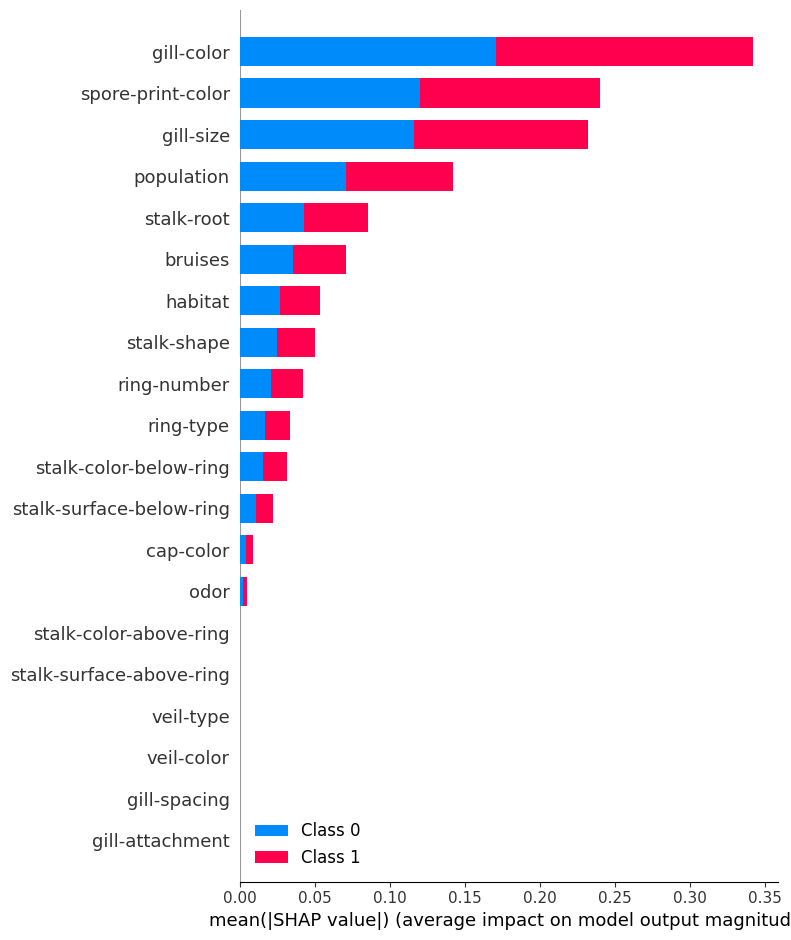

In [124]:
shap.initjs()
shap.summary_plot(shap_values_DT_5_gc, X5_gc_test, plot_type="bar")

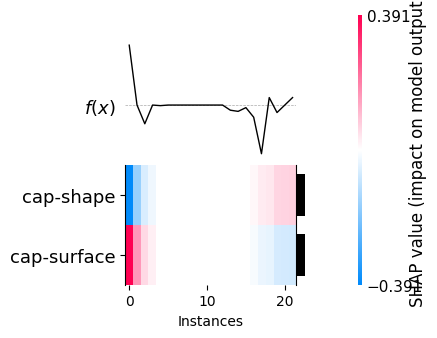

In [128]:
shap.initjs()
shap.plots.heatmap(shap_values2_DT_5_gc[0])

In [129]:
GBDT_5_gc = GradientBoostingClassifier()
param_grid_GBDT_5_gc = {
    'n_estimators': [10,20,30,40,50],     # no of trees
    'learning_rate': [0.01, 0.1, 0.2],       # learning rate
    'max_depth': [3, 5, 7, 10],              # max depth of trees
    'subsample': [0.8, 1.0],                 # fraction of instances
    'max_features': ['auto', 'sqrt', 0.5],   # fraction of features
}



In [130]:

halving_search_GBDT_5_gc = HalvingGridSearchCV(GBDT_5_gc, param_grid_GBDT_5_gc, scoring='f1', n_jobs=-1, verbose=2, return_train_score=True, cv = K_fold)


halving_search_GBDT_5_gc.fit(X_5_gc, y_5_gc)


n_iterations: 5
n_required_iterations: 6
n_possible_iterations: 5
min_resources_: 40
max_resources_: 8124
aggressive_elimination: False
factor: 3
----------
iter: 0
n_candidates: 360
n_resources: 40
Fitting 10 folds for each of 360 candidates, totalling 3600 fits
----------
iter: 1
n_candidates: 120
n_resources: 120
Fitting 10 folds for each of 120 candidates, totalling 1200 fits
----------
iter: 2
n_candidates: 40
n_resources: 360
Fitting 10 folds for each of 40 candidates, totalling 400 fits
----------
iter: 3
n_candidates: 14
n_resources: 1080
Fitting 10 folds for each of 14 candidates, totalling 140 fits
----------
iter: 4
n_candidates: 5
n_resources: 3240
Fitting 10 folds for each of 5 candidates, totalling 50 fits


HalvingGridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=True),
                    estimator=GradientBoostingClassifier(), n_jobs=-1,
                    param_grid={'learning_rate': [0.01, 0.1, 0.2],
                                'max_depth': [3, 5, 7, 10],
                                'max_features': ['auto', 'sqrt', 0.5],
                                'n_estimators': [10, 20, 30, 40, 50],
                                'subsample': [0.8, 1.0]},
                    scoring='f1', verbose=2)

In [131]:
cv_results_GBDT_5_gc = halving_search_GBDT_5_gc.cv_results_
print("Mean test f1-score:", cv_results_GBDT_5_gc['mean_test_score'])
print("Mean train f1-score:", cv_results_GBDT_5_gc['mean_train_score'])

Mean test f1-score: [0.69904762 0.68       0.72666667 0.79333333 0.78       0.82666667
 0.86       0.86       0.86       0.86       0.63238095 0.77904762
 0.70666667 0.74       0.76       0.76       0.76       0.86
 0.86       0.82666667 0.61809524 0.71333333 0.76       0.74
 0.82666667 0.76       0.86       0.86       0.86       0.86
 0.66571429 0.69333333 0.70666667 0.70666667 0.72666667 0.72666667
 0.86       0.86       0.82666667 0.86       0.74809524 0.77904762
 0.71238095 0.71238095 0.88       0.76       0.86       0.86
 0.86       0.86       0.63238095 0.71238095 0.71238095 0.74571429
 0.76       0.86       0.82666667 0.86       0.86       0.86
 0.71238095 0.74       0.76       0.70666667 0.86       0.72666667
 0.86       0.82666667 0.86       0.82666667 0.69809524 0.72571429
 0.76       0.74       0.76       0.76       0.86       0.86
 0.86       0.86       0.69666667 0.71238095 0.74       0.74
 0.86       0.76       0.86       0.86       0.82666667 0.86
 0.59904762 0.69333333 

In [132]:
# gain the best hyperparameters
best_params_GBDT_5_gc = halving_search_GBDT_5_gc.best_params_

# gain the best model
best_model_GBDT_5_gc = halving_search_GBDT_5_gc.best_estimator_
best_params_GBDT_5_gc

{'learning_rate': 0.1,
 'max_depth': 5,
 'max_features': 0.5,
 'n_estimators': 50,
 'subsample': 0.8}

In [133]:
shap.initjs()
explainer_GBDT_5_gc = shap.TreeExplainer(best_model_GBDT_5_gc)
shap_values_GBDT_5_gc = explainer_GBDT_5_gc.shap_values(X5_gc_test)
shap_values2_GBDT_5_gc = explainer_GBDT_5_gc(X5_gc_test)
shap.force_plot(explainer_GBDT_5_gc.expected_value[0], shap_values_GBDT_5_gc, X5_gc_test)


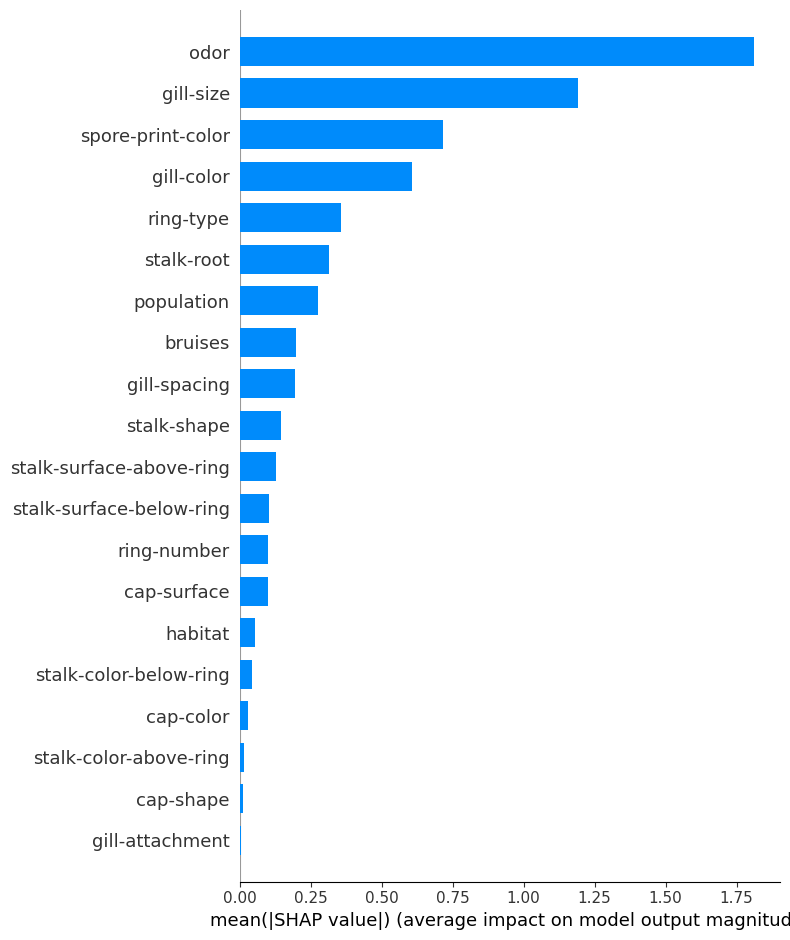

In [134]:
shap.initjs()
shap.summary_plot(shap_values_GBDT_5_gc, X5_gc_test, plot_type="bar")

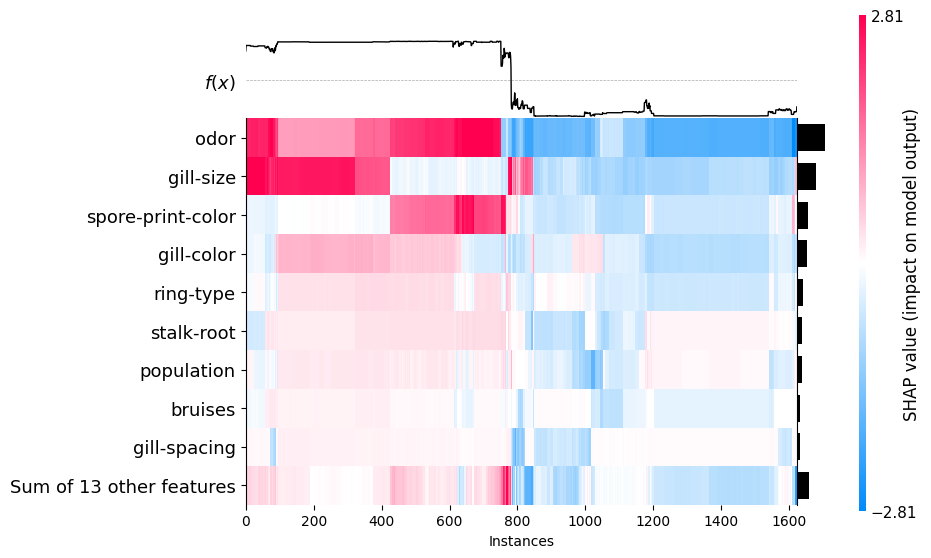

In [135]:
shap.initjs()
shap.plots.heatmap(shap_values2_GBDT_5_gc)

# noise adding


In [24]:
noise_ratio = 0.1
total_samples = len(data)
noise_samples = int(total_samples * noise_ratio)
noise_samples


812

In [25]:

mushroom_data = data.copy()
cap_shape_labels = mushroom_data['cap-shape'].unique()
global_distribution = mushroom_data['cap-shape'].value_counts(normalize=True)


In [26]:
# 计算每个类别需要添加的噪声样本数量，保持全局分布
noise_counts = (global_distribution * len(mushroom_data) * noise_ratio).astype(int)

# 为每个类别生成随机噪声数据并进行替换
for label, count in noise_counts.items():
    # 获取该类别的索引
    indices = mushroom_data.index[mushroom_data['cap-shape'] == label].tolist()
    # 从索引中随机选择需要替换的样本
    replace_indices = np.random.choice(indices, count, replace=False)

    # 获取该类别需要替换为的其他类别
    other_labels = global_distribution.index[global_distribution.index != label]
    replace_label = np.random.choice(other_labels)

    # 将该类别的样本替换为其他随机类别
    mushroom_data.loc[replace_indices, 'cap-shape'] = replace_label


In [27]:
noise_counts

5    365
2    315
3     82
0     45
4      3
1      0
Name: cap-shape, dtype: int64

In [28]:
data['cap-shape'].value_counts()

5    3656
2    3152
3     828
0     452
4      32
1       4
Name: cap-shape, dtype: int64

In [29]:
mushroom_data['cap-shape'].value_counts()

5    3291
2    2837
3    1109
0     854
4      29
1       4
Name: cap-shape, dtype: int64

In [30]:
data == mushroom_data

,class,cap-shape,cap-surface,cap-color,bruises,odor,gill-attachment,gill-spacing,gill-size,gill-color,...,stalk-surface-below-ring,stalk-color-above-ring,stalk-color-below-ring,veil-type,veil-color,ring-number,ring-type,spore-print-color,population,habitat
0,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
1,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
2,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
3,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
4,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8119,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
8120,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
8121,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
8122,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True


In [31]:
mush_X = mushroom_data.iloc[:,1:23]  # all rows, all the features and no labels
mush_y = mushroom_data.iloc[:, 0]  # all rows, label only

In [34]:
param_grid = {
    'criterion': ['gini', 'entropy'],
    'max_depth': [ 5, 10, 20],  # 可以根据数据集的大小和复杂性调整
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'max_features': [ 'sqrt', 'log2'],
    'min_impurity_decrease': [0.0, 0.1, 0.2],
}

model_test = DecisionTreeClassifier()


In [35]:
from sklearn.experimental import enable_halving_search_cv
from sklearn.model_selection import HalvingGridSearchCV, KFold


In [36]:
K_fold =  KFold(n_splits=10, shuffle=True, random_state=42)

In [56]:

halving_search = HalvingGridSearchCV(model_test, param_grid, scoring='f1', n_jobs=-1, verbose=2, return_train_score=True, cv = K_fold)


halving_search.fit(mush_X, mush_y)


n_iterations: 5
n_required_iterations: 6
n_possible_iterations: 5
min_resources_: 40
max_resources_: 8124
aggressive_elimination: False
factor: 3
----------
iter: 0
n_candidates: 324
n_resources: 40
Fitting 10 folds for each of 324 candidates, totalling 3240 fits
----------
iter: 1
n_candidates: 108
n_resources: 120
Fitting 10 folds for each of 108 candidates, totalling 1080 fits
----------
iter: 2
n_candidates: 36
n_resources: 360
Fitting 10 folds for each of 36 candidates, totalling 360 fits
----------
iter: 3
n_candidates: 12
n_resources: 1080
Fitting 10 folds for each of 12 candidates, totalling 120 fits
----------
iter: 4
n_candidates: 4
n_resources: 3240
Fitting 10 folds for each of 4 candidates, totalling 40 fits


HalvingGridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=True),
                    estimator=DecisionTreeClassifier(), n_jobs=-1,
                    param_grid={'criterion': ['gini', 'entropy'],
                                'max_depth': [5, 10, 20],
                                'max_features': ['sqrt', 'log2'],
                                'min_impurity_decrease': [0.0, 0.1, 0.2],
                                'min_samples_leaf': [1, 2, 4],
                                'min_samples_split': [2, 5, 10]},
                    scoring='f1', verbose=2)

In [38]:
cv_results = halving_search.cv_results_
print("Mean test f1-score:", cv_results['mean_test_score'])
print("Mean train f1-score:", cv_results['mean_train_score'])


Mean test f1-score: [0.61       0.68       0.62666667 0.72666667 0.57666667 0.59666667
 0.71333333 0.58       0.62333333 0.59333333 0.43333333 0.56333333
 0.63333333 0.59333333 0.57333333 0.5        0.48       0.51666667
 0.44666667 0.53       0.47666667 0.64       0.45666667 0.61333333
 0.41333333 0.42666667 0.34666667 0.71666667 0.69666667 0.61333333
 0.67666667 0.79333333 0.69       0.59333333 0.69666667 0.59333333
 0.45       0.44333333 0.56       0.59666667 0.5        0.62666667
 0.64666667 0.56333333 0.57333333 0.39666667 0.29666667 0.32666667
 0.52666667 0.37666667 0.32666667 0.41333333 0.26333333 0.39333333
 0.68       0.68       0.51333333 0.66333333 0.63       0.69666667
 0.64666667 0.79666667 0.64666667 0.64333333 0.59333333 0.41333333
 0.52666667 0.59666667 0.44666667 0.58       0.58333333 0.51333333
 0.48       0.31333333 0.36333333 0.37666667 0.37666667 0.32666667
 0.39666667 0.45666667 0.29666667 0.63       0.69666667 0.74
 0.73       0.66333333 0.62666667 0.71       0.6

In [39]:
# 获取最佳超参数
best_params = halving_search.best_params_

# 获取最佳模型
best_model = halving_search.best_estimator_
best_params

{'criterion': 'gini',
 'max_depth': 20,
 'max_features': 'log2',
 'min_impurity_decrease': 0.0,
 'min_samples_leaf': 1,
 'min_samples_split': 2}

In [43]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(mush_X, mush_y, test_size=0.2, stratify=y, random_state=42)



In [41]:
shap.initjs()
explainer = shap.TreeExplainer(best_model)

shap_values = explainer.shap_values(X_test)
shap.force_plot(explainer.expected_value[0], shap_values[0], X_test)

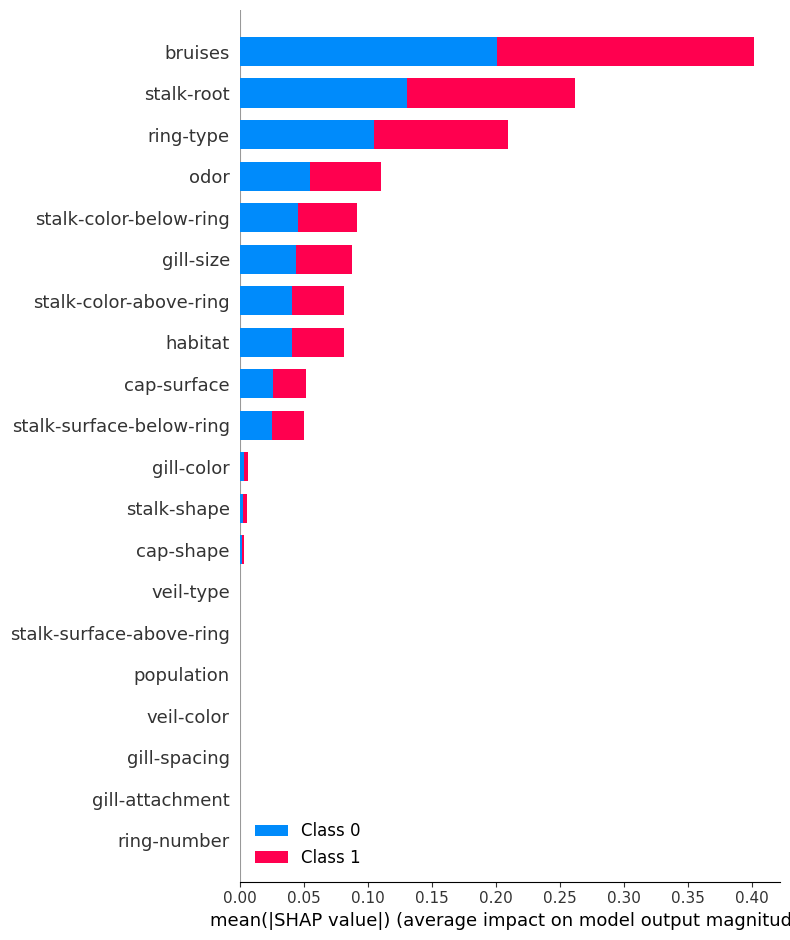

In [42]:
shap.summary_plot(shap_values, X, plot_type="bar")
